## Modeling approach

Since all trajectories are given, it is possible to get the explicit formulae for the force.


Angels:

$$
\begin{aligned}
\alpha(t)=\omega_1 t \\
\beta(t)=-\omega_2 t
\end{aligned}
$$

Positions of points B and C (starting from the vertical positions):

$$
\begin{aligned}
\vec{r}_B &= l_1 \begin{bmatrix} \sin \alpha  \\ \cos \alpha \end{bmatrix} = l_1 \begin{bmatrix} \sin \omega_1 t  \\ \cos \omega_1 t \end{bmatrix} \\ 
\vec{r}_C &= l_2 \begin{bmatrix} \sin (\alpha + \beta) \\ \cos (\alpha + \beta) \end{bmatrix} + \vec{r}_B =  l_2 \begin{bmatrix}  \sin \delta \omega_1 t \\ \cos \delta \omega_1 t \end{bmatrix} + \vec{r}_B
\end{aligned} \\
\delta \omega = \omega_1 - \omega_2

$$

Newton's equations for link 1 (BC), link 2 (AB), point B and point C:
$$
\begin{cases}
\vec{F}_{2C} + \vec{F}_{2B} = 0 \\
\vec{F}_{1B} + \vec{F}_{1A} = 0 \\
\ddot{\vec{r}}_C m_C = \vec{F}_{2C} \\
\ddot{\vec{r}}_B m_B = \vec{F}_{1B} + \vec{F}_{2B}
\end{cases}
$$

Axial force in link 1 comes from $\vec{F}_{1B}$, so we need to find it:

$$
\begin{aligned}
\vec{F}_{1B}  = \ddot{\vec{r}}_B m_B  - \vec{F}_{2B} = \ddot{\vec{r}}_B m_B + \vec{F}_{2C} = \ddot{\vec{r}}_B m_B + \ddot{\vec{r}}_C m_C = \\
=-\omega_1^2 l_1 (m_B+m_C) \begin{bmatrix} \sin \omega_1 t  \\ \cos \omega_1 t \end{bmatrix} - \delta \omega^2 l_2 m_C \begin{bmatrix}  \sin \delta \omega t \\ \cos \delta \omega t \end{bmatrix} 
\end{aligned}
$$

To get an axial part of $\vec{F}_{1B}$ we need to project it on the direction of link 1 (vector $\vec{r}_B$):

$$
\begin{aligned}
F_{1B, axial} = \left( \vec{F}_{1B} \cdot \frac{\vec{r}_B}{|\vec{r}_B|} \right) = -\omega_1^2 l_1 (m_B+m_C) - \delta \omega^2 l_2 m_C \cos \omega_2 t
\end{aligned}
$$

Now, the force $F_{1B, axial}$ is the force which is acting on point B from link 1 (AB). The axial force in link 1 is the opposite of it:

$$
\begin{aligned}
 F_{1, axial} &= -F_{1B, axial} = \omega_1^2 l_1 (m_B+m_C) +  (\omega_1 - \omega_2)^2 l_2 m_C \cos \omega_2 t
\end{aligned}
$$

This matches with the convention where tensile force is has the positive sign.


## Modelling

In [1]:
# Uncomment this to install the  packages, Using venv is strongly recommended.
# !pip install numpy matplotlib

In [2]:
import numpy as np
import matplotlib.pyplot as plt

In [3]:
# Introducing geometry sets
geometry_sets = [
    {
        "l1": 2.,
        "l2": 1.,
        "mb": 2.,
        "mc": 1.,
        "name_gs": "Long inner link, heavy inner mass"
    },
    {
        "l1": 1.,
        "l2": 2.,
        "mb": 1.,
        "mc": 2,
        "name_gs": "Short inner link, light inner mass"
    },
    {
        "l1": 2.,
        "l2": 1.,
        "mb": 1.,
        "mc": 2,
        "name_gs": "Long inner link, light inner mass"
    },
    {
        "l1": 1.,
        "l2": 2.,
        "mb": 2.,
        "mc": 1.,
        "name_gs": "Short inner link, heavy inner mass"
    },
    {
        "l1": 2.1,
        "l2": 2.,
        "mb": 1,
        "mc": 1.1,
        "name_gs": "Equal links, heavy masses"
    }
]


In [4]:
# Introducing motion sets

motion_sets = [
    {
        "omega1": 3.,
        "omega2": 1.,
        "name_ms": "inner:outer speeds 3:1"
    },
        {
        "omega1": 2.,
        "omega2": 1.,
        "name_ms": "inner:outer speeds 2:1"
    },
    {
        "omega1": 2.1,
        "omega2": 2.,
        "name_ms": "inner:outer speeds almost 1:1"
    },
    {
        "omega1": 1.,
        "omega2": 2.,
        "name_ms": "inner:outer speeds 1:2"
    },
    {
        "omega1": 1.,
        "omega2": 3.,
        "name_ms": "inner:outer speeds 1:3"
    },
]

In [5]:
# Functions

def axial_force(t, omega1, omega2, mb, mc, l1, l2):
    return omega1**2 * (mb + mc) * l1  + (omega1 - omega2)**2 * mc * l2 * np.cos(omega2 * t)

def inner_link_angle(t, omega1):
    return omega1 * t


def max_axial_force(omega1, omega2, mb, mc, l1, l2):
    return omega1**2 * (mb + mc) * l1  + (omega1 - omega2)**2 * mc * l2

def min_axial_force(omega1, omega2, mb, mc, l1, l2):
    return omega1**2 * (mb + mc) * l1  - (omega1 - omega2)**2 * mc * l2




In [6]:
absolute_max_force = -np.inf
absolute_min_force = np.inf
ig_max = None
im_max = None
ig_min = None
im_min = None
for  im, motion_set in enumerate(motion_sets):
    for ig, geometry_set in enumerate(geometry_sets):
        max_force_sample = max_axial_force(
            omega1=motion_set["omega1"],
            omega2=motion_set["omega2"],
            mb=geometry_set["mb"],
            mc=geometry_set["mc"],
            l1=geometry_set["l1"],
            l2=geometry_set["l2"]
        )

        min_force_sample = min_axial_force(
            omega1=motion_set["omega1"],
            omega2=motion_set["omega2"],
            mb=geometry_set["mb"],
            mc=geometry_set["mc"],
            l1=geometry_set["l1"],
            l2=geometry_set["l2"]
        )
        if max_force_sample > absolute_max_force:
            absolute_max_force = max_force_sample
            print(f"New max force found: {absolute_max_force} for motion set {motion_set['name_ms']} and geometry set {geometry_set['name_gs']}")
            ig_max = ig
            im_max = im
        if min_force_sample < absolute_min_force:
            absolute_min_force = min_force_sample
            print(f"New min force found: {absolute_min_force} for motion set {motion_set['name_ms']} and geometry set {geometry_set['name_gs']}")
            ig_min = ig
            im_min = im

New max force found: 58.0 for motion set inner:outer speeds 3:1 and geometry set Long inner link, heavy inner mass
New min force found: 50.0 for motion set inner:outer speeds 3:1 and geometry set Long inner link, heavy inner mass
New min force found: 11.0 for motion set inner:outer speeds 3:1 and geometry set Short inner link, light inner mass
New max force found: 62.0 for motion set inner:outer speeds 3:1 and geometry set Long inner link, light inner mass
New min force found: 8.0 for motion set inner:outer speeds 2:1 and geometry set Short inner link, light inner mass
New min force found: 5.0 for motion set inner:outer speeds 1:2 and geometry set Long inner link, heavy inner mass
New min force found: -1.0 for motion set inner:outer speeds 1:2 and geometry set Short inner link, light inner mass
New min force found: -13.0 for motion set inner:outer speeds 1:3 and geometry set Short inner link, light inner mass


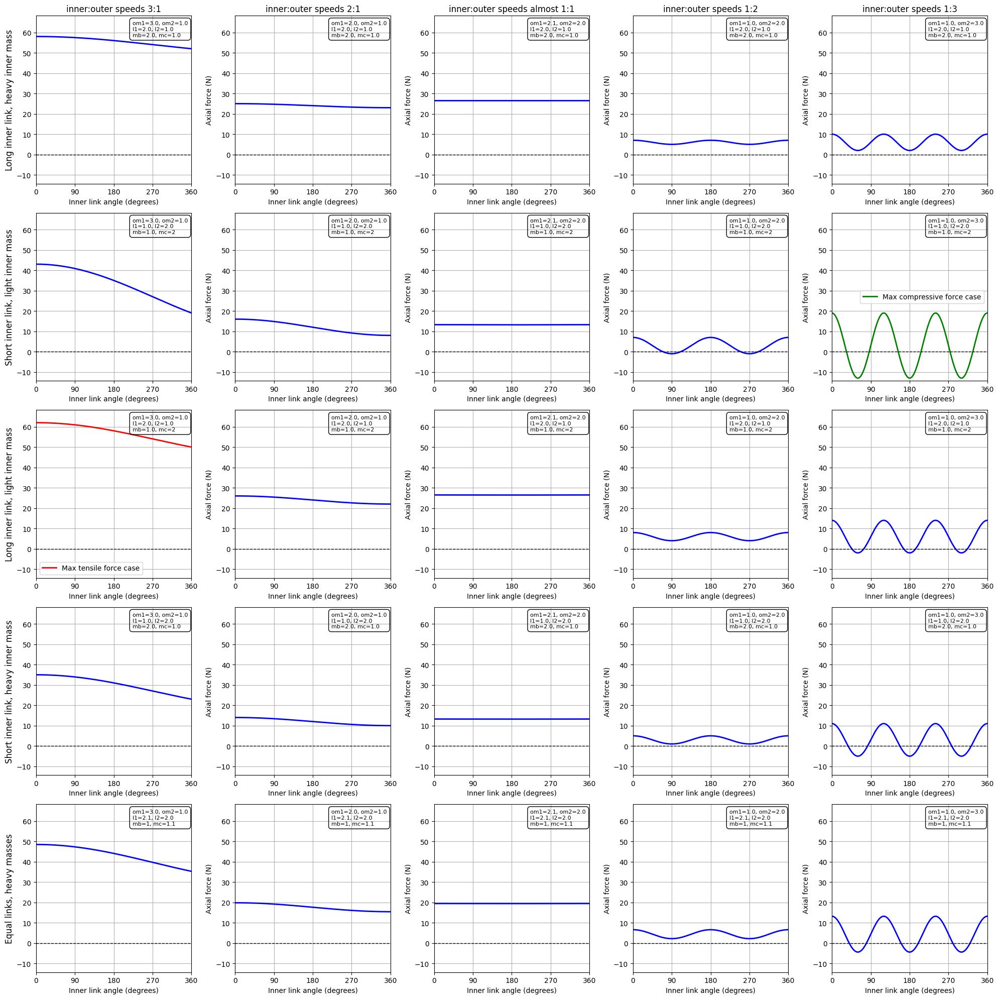

In [7]:
fig, axs = plt.subplots(5,5, figsize=(20, 20))
am = 0
for  im, motion_set in enumerate(motion_sets):
    for ig, geometry_set in enumerate(geometry_sets):
        ax = axs[ig, im]
        t_max = 2* np.pi / motion_set["omega1"]
        t_values = np.linspace(0, t_max, 1000)
        angles = inner_link_angle(t_values, motion_set["omega1"])
        
        forces = axial_force(
            t_values, 
            omega1=motion_set["omega1"],
            omega2=motion_set["omega2"],
            mb=geometry_set["mb"],
            mc=geometry_set["mc"],
            l1=geometry_set["l1"],
            l2=geometry_set["l2"]
        
        )


        color = 'blue'
        label = None
        if ig == ig_max and im == im_max:
            color = 'red'
            label = 'Max tensile force case'
        elif ig == ig_min and im == im_min:
            color = 'green'
            label = 'Max compressive force case'
        
        ax.plot(angles, forces, linewidth=2, color=color, label=label)
        ax.plot([0, 2*np.pi], [0, 0], color='black', linestyle='--', linewidth=1)

        # ax.set_title(f"{motion_set['name_ms']} \n {geometry_set['name_gs']}")
        ax.set_xlabel("Inner link angle (degrees)") 
        ax.set_ylabel("Axial force (N)")
        ax.set_xlim(0, 2*np.pi)
        ax.set_xticks([0, np.pi/2, np.pi, 3*np.pi/2, 2*np.pi])
        ax.set_xticklabels(['0', '90', '180', '270', '360'])
        ax.set_ylim(absolute_min_force*1.1, absolute_max_force*1.1)
        ax.grid()

        txt = ax.text(
            0.62, 0.97,
            f"om1={motion_set['omega1']}, om2={motion_set['omega2']}\nl1={geometry_set['l1']}, l2={geometry_set['l2']}\nmb={geometry_set['mb']}, mc={geometry_set['mc']}",
            transform=ax.transAxes,
            ha="left", va="top", fontsize=8,
            bbox=dict(facecolor='none', edgecolor='black', boxstyle='round,pad=0.5')
        )
        if label is not None:
            ax.legend()

for  im, motion_set in enumerate(motion_sets):
    axs[0, im].set_title(motion_set['name_ms'], fontsize= 12)

for ig, geometry_set in enumerate(geometry_sets):
    axs[ig, 0].set_ylabel(geometry_set['name_gs'], va='center', labelpad=10, fontsize= 12)

fig.tight_layout()

## Final engineering insight

### Which combination produces the highest tensile force in AB?

A combination with a longer inner link (AB), heavier inner mass (B) and large inner angular speed produced maximum tensile force.

### Which produces the highest compressive force?

A combination with a shorter inner link (AB), lighter inner mass (B) and large outer angular speed produced maximum compression force.

### What physical parameter primarily drives the extreme loads?
The primarily drivers of physical loads are angular speeds, as they their contribution is squared while other parameters appear linearly. extreme tensile loads are primarily driven by $\omega_1$ (inner link angular speed),
as it is contributes as a rotation of a mass at a fixed radius. The compression loads are mostly driven by $\omega_2$, as it is appears (as well squared) as a coefficient in front of cosie in the second term, and only that term can make the force tensile.

## Animation
(might take a while to render)

In [8]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


def point_B_coords(t, l1, omega1):
    x_B = l1 * np.cos(omega1 * t)
    y_B = l1 * np.sin(omega1 * t)
    return x_B, y_B

def point_C_coords(t, l1, l2, omega1, omega2):
    x_B, y_B = point_B_coords(t, l1, omega1)
    x_C = x_B + l2 * np.cos((omega1 - omega2) * t)
    y_C = y_B + l2 * np.sin((omega1 - omega2) * t)
    return x_C, y_C


fps = 30
T = 8  
t_vals = np.linspace(0, T, fps * T)
max_reach = max(gs["l1"] + gs["l2"] for gs in geometry_sets) + 0.4
trail_len = 150


fig, axes = plt.subplots(5, 5, figsize=(16, 16), tight_layout=True)
def mass_to_size(m):
    return 4 + 4 * m  

cells = []  # 
for im, ms in enumerate(motion_sets):    
    for ig, gs in enumerate(geometry_sets):
        ax = axes[ig, im]
        ax.set_aspect("equal")
        ax.set_xlim(-max_reach, max_reach)
        ax.set_ylim(-max_reach, max_reach)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.grid(True, alpha=0.25)

        color = 'blue'
        label = None
        if ig == ig_max and im == im_max:
            color = 'red'
            label = 'Max tensile force'
        elif ig == ig_min and im == im_min:
            color = 'green'
            label = 'Max compressive force'

        rod1_line, = ax.plot([], [], lw=2, color=color)
        rod2_line, = ax.plot([], [], lw=2,color=color)



        base_pt, = ax.plot([], [], 'o', ms=4)  
        B_pt, = ax.plot([], [], 'o', ms=mass_to_size(gs["mb"]), color=color)
        C_pt, = ax.plot([], [], 'o', ms=mass_to_size(gs["mc"]), color=color)

        trail_line, = ax.plot([], [], lw=1.0, alpha=0.7,color=color)

        txt = ax.text(
            0.02, 0.98,
            f"om1={motion_set['omega1']}, om2={motion_set['omega2']}\nl1={geometry_set['l1']}, l2={geometry_set['l2']}\nmb={geometry_set['mb']}, mc={geometry_set['mc']}",
            transform=ax.transAxes,
            ha="left", va="top", fontsize=8,
            bbox=dict(facecolor='none', edgecolor='black', boxstyle='round,pad=0.5')
        )

        cells.append({
            "ax": ax,
            "motion": ms,
            "geom": gs,
            "rod1_line": rod1_line,
            "rod2_line": rod2_line,
            "base_pt": base_pt,
            "B_pt": B_pt,
            "C_pt": C_pt,
            "trail_line": trail_line,
            "trail_x": [],
            "trail_y": [],
            "txt": txt,
        })

for  im, motion_set in enumerate(motion_sets):
    axs[0, im].set_title(motion_set['name_ms'], fontsize= 12)

for ig, geometry_set in enumerate(geometry_sets):
    axs[ig, 0].set_ylabel(geometry_set['name_gs'], va='center', labelpad=10, fontsize= 12)



def init():
    artists = []
    for cell in cells:
        cell["rod1_line"].set_data([], [])
        cell["rod2_line"].set_data([], [])
        cell["base_pt"].set_data([], [])
        cell["B_pt"].set_data([], [])
        cell["C_pt"].set_data([], [])
        cell["trail_line"].set_data([], [])
        cell["trail_x"].clear()
        cell["trail_y"].clear()

        artists.extend([
            cell["rod1_line"], cell["rod2_line"],
            cell["base_pt"], cell["B_pt"], cell["C_pt"],
            cell["trail_line"], cell["txt"]
        ])
    return artists

def update(frame):
    t = t_vals[frame]
    artists = []

    for cell in cells:
        ms = cell["motion"]
        gs = cell["geom"]

        l1, l2 = gs["l1"], gs["l2"]
        omega1, omega2 = ms["omega1"], ms["omega2"]

        x0, y0 = 0.0, 0.0
        xB, yB = point_B_coords(t, l1, omega1)
        xC, yC = point_C_coords(t, l1, l2, omega1, omega2)

        cell["rod1_line"].set_data([x0, xB], [y0, yB])
        cell["rod2_line"].set_data([xB, xC], [yB, yC])

        cell["base_pt"].set_data([x0], [y0])
        cell["B_pt"].set_data([xB], [yB])
        cell["C_pt"].set_data([xC], [yC])

        cell["trail_x"].append(xC)
        cell["trail_y"].append(yC)

        if trail_len is not None and len(cell["trail_x"]) > trail_len:
            cell["trail_x"] = cell["trail_x"][-trail_len:]
            cell["trail_y"] = cell["trail_y"][-trail_len:]

        cell["trail_line"].set_data(cell["trail_x"], cell["trail_y"])

        artists.extend([
            cell["rod1_line"], cell["rod2_line"],
            cell["base_pt"], cell["B_pt"], cell["C_pt"],
            cell["trail_line"], cell["txt"]
        ])

    return artists

ani = FuncAnimation(fig, update, frames=len(t_vals),init_func=init, interval=1000/fps, blit=True)
plt.close(fig) 
HTML(ani.to_jshtml())

Animation size has reached 20998398 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
